# MTA Ridership & Turnstile‑Hopping Data Visualization  
**MTA Open Data Challenge – Sep 2024 → Nov 2024**  

**Author:** Ibrahim Faruquee  
**Tools:** Python 3.11, pandas, NumPy, matplotlib, seaborn, folium, contextily, scikit‑learn  
**Deliverables:**  
- Animated geographic scatterplots of hourly subway ridership  
- Spatial join of turnstile‑hopping incidents with NYPD arrest records  
- Interactive Folium map for stakeholder exploration

## Project Overview  

The goal of this project is to explore two complementary open‑data sets released by the MTA and NYPD:

| Dataset | Source | Key Fields |
|---------|--------|------------|
| **MTA Subway Hourly Ridership** | https://data.ny.gov/Transportation/MTA-Subway-Hourly-Ridership-Beginning-February-202… | `station_complex`, `latitude`, `longitude`, `transit_timestamp`, `ridership` |
| **NYPD Arrests (Turnstile‑Jumping)** | https://data.cityofnewyork.us/Public-Safety/NYPD-Arrests-Data-Historic-/8h9b‑rp9u/about_data | `ARREST_KEY`, `ARREST_DATE`, `PD_DESC`, `Latitude`, `Longitude` |

**Objectives**

1. Visualize spatial‑temporal ridership patterns across the NYC subway network.  
2. Identify “turnstile‑hopping” incidents and associate each incident with its nearest subway station.  
3. Produce an enriched arrests table that includes the nearest station name.  
4. Deliver interactive visual assets (animated GIFs, Folium map) for stakeholder review.  

In [ ]:
# Uncomment for library installations
# %pip install pandas numpy matplotlib seaborn scipy folium ipython tqdm contextily pillow jupyterlab

In [24]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import matplotlib.dates as mdates
import contextily as ctx
from matplotlib.colors import LinearSegmentedColormap
from IPython.display import Image, display
from scipy.spatial.distance import cdist
import folium
from folium.plugins import MarkerCluster

## Load Ridership Data

In [ ]:
# Load data from CSV file into a pandas DataFrame
df = pd.read_csv('clean_subway.csv')

df.sample(10)

In [26]:
print(df['station_complex_id'].value_counts())
df[df['station_complex_id'] == 76]

station_complex_id
628    17430
620    14267
606    13756
611    13654
617    12381
       ...  
83      2660
84      2622
86      2573
85      2551
8       1604
Name: count, Length: 449, dtype: int64


,station_complex_id,transit_timestamp,transit_mode,station_complex,borough,latitude,longitude,Georeference,ridership,transfers
211204,76,2024-01-02 07:00:00,subway,Bay Pkwy (N),Brooklyn,40.611816,-73.98185,POINT (-73.98185 40.611816),242,12
211205,76,2024-01-04 18:00:00,subway,Bay Pkwy (N),Brooklyn,40.611816,-73.98185,POINT (-73.98185 40.611816),9,0
211206,76,2024-01-07 00:00:00,subway,Bay Pkwy (N),Brooklyn,40.611816,-73.98185,POINT (-73.98185 40.611816),4,0
211207,76,2024-01-07 01:00:00,subway,Bay Pkwy (N),Brooklyn,40.611816,-73.98185,POINT (-73.98185 40.611816),2,0
211208,76,2024-01-07 02:00:00,subway,Bay Pkwy (N),Brooklyn,40.611816,-73.98185,POINT (-73.98185 40.611816),3,0
...,...,...,...,...,...,...,...,...,...,...
2807410,76,2024-09-05 19:00:00,subway,Bay Pkwy (N),Brooklyn,40.611816,-73.98185,POINT (-73.98185 40.611816),111,3
2807411,76,2024-09-05 20:00:00,subway,Bay Pkwy (N),Brooklyn,40.611816,-73.98185,POINT (-73.98185 40.611816),70,2
2807412,76,2024-09-05 21:00:00,subway,Bay Pkwy (N),Brooklyn,40.611816,-73.98185,POINT (-73.98185 40.611816),34,1
2807413,76,2024-09-05 22:00:00,subway,Bay Pkwy (N),Brooklyn,40.611816,-73.98185,POINT (-73.98185 40.611816),38,1


In [27]:
len(df)

2890213

In [28]:
df.drop_duplicates(inplace=True)
len(df)

2886421

In [29]:
# Convert transit_timestamp to datetime
df['transit_timestamp'] = pd.to_datetime(df['transit_timestamp'])

# Create custom colormap
colors = ['darkgreen', 'green', 'yellowgreen', 'yellow', 'orange', 'red', 'darkred']
n_bins = 100
cmap = LinearSegmentedColormap.from_list('custom', colors, N=n_bins)

## Hourly Ridership in 2024 Scatterplot with Map [Video link](https://drive.google.com/file/d/1sJ4-koWbKP9pjz77QskDxehcztZik7fC/view?usp=sharing)
Created an animated scatterplot that displays the ridership of every station hourly over the coarse of 2024. It uses colorful dots to represent each station's ridership, with red indicating high usage, yellow for average, and green for low. As the animation progresses, viewers can see how subway usage changes hour by hour, with the date and the time in the top left corner. Using contextily library to map the scatterplot points on a map. Map data is from OpenStreetMaps.

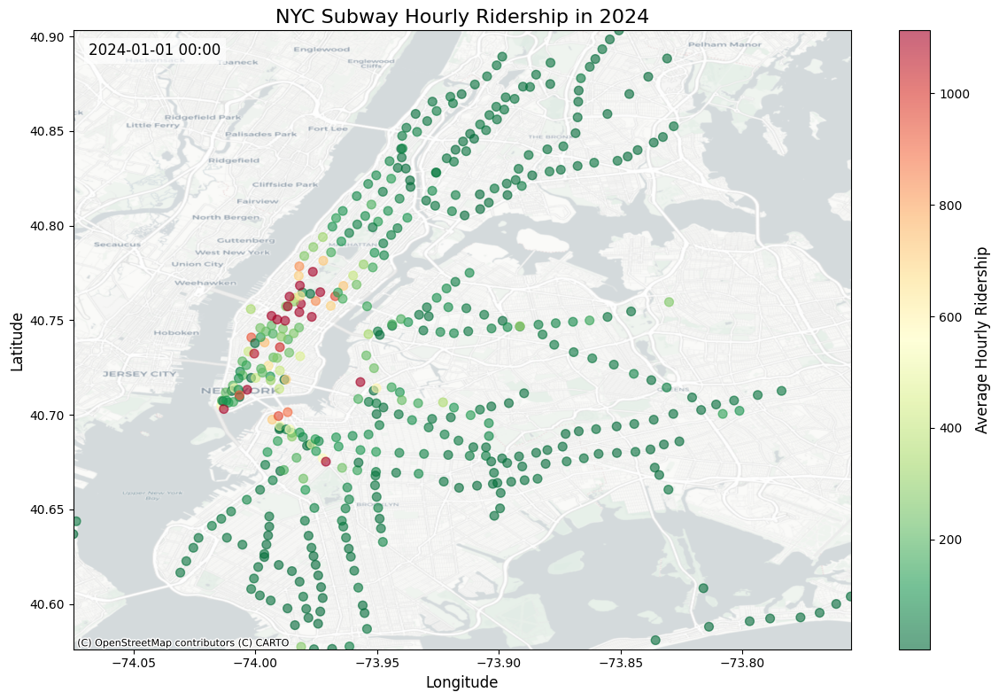

Animation saved successfully.


In [34]:
# Create an hourly timestamp column as integer
df['hour'] = df['transit_timestamp'].dt.floor('H')

# Group by station and hour, calculating mean hourly ridership
hourly_data = df.groupby(['station_complex', 'hour', 'latitude', 'longitude'])['ridership'].mean().reset_index()

# Calculate percentiles for normalization
low, high = np.percentile(hourly_data['ridership'], [5, 95])

# Create figure and axis
fig, ax = plt.subplots(figsize=(12, 8))

# Set up the plot limits based on your data
ax.set_xlim(df['longitude'].min(), df['longitude'].max())
ax.set_ylim(df['latitude'].min(), df['latitude'].max())

# Add a background map using contextily
ctx.add_basemap(ax, crs="EPSG:4326", source=ctx.providers.CartoDB.Positron)

# Initialize scatter plot with RdYlGn_r colormap
scatter = ax.scatter([], [], c=[], cmap='RdYlGn_r', alpha=0.6, s=50, vmin=low, vmax=high)

# Set up the plot
ax.set_title('NYC Subway Hourly Ridership in 2024', fontsize=16)
ax.set_xlabel('Longitude', fontsize=12)
ax.set_ylabel('Latitude', fontsize=12)

# Add colorbar
cbar = plt.colorbar(scatter)
cbar.set_label('Average Hourly Ridership', fontsize=12)

# Add timestamp text
timestamp_text = ax.text(0.02, 0.98, '', transform=ax.transAxes, fontsize=12, verticalalignment='top', 
                         bbox=dict(facecolor='white', alpha=0.7, edgecolor='none'))

# Get unique hours for animation
unique_hours = sorted(hourly_data['hour'].unique())

# Animation update function
def update(frame):
    current_hour = unique_hours[frame]
    current_data = hourly_data[hourly_data['hour'] == current_hour]
    
    scatter.set_offsets(current_data[['longitude', 'latitude']])
    scatter.set_array(current_data['ridership'])
    
    timestamp_text.set_text(current_hour.strftime('%Y-%m-%d %H:%M'))
    
    return scatter, timestamp_text

# Create animation
ani = animation.FuncAnimation(fig, update, frames=len(unique_hours), 
                              interval=200, blit=True)

plt.tight_layout()
plt.show()

# Uncomment the following line to save the animation as gif (requires pillow)
ani.save('nyc_subway_hourly_ridership_in_2024_with_map.gif', writer='pillow', fps=20)
print("Animation saved successfully.")

In [35]:
# Unable to display gif. File too large.
# display(Image(filename='nyc_subway_hourly_ridership_in_2024_with_map.gif'))

## Average Hourly Rideship with Map [Video Link](https://drive.google.com/file/d/1TwE1bH0pRF_IlfH80oufrXoxx6WP0Jz3/view?usp=sharing)
Created an animated scatterplot of average hourly ridership. It averages together the 2024 data to show how ridership patterns change throughout an average day, using color-coded dots to represent each station's average ridership for each hour. The animation cycles through 24 hours, updating the map to reflect ridership levels at each station. A text label in the corner updates to show the current hour. Using contextily library to map the scatterplot points on a map. Map data is from OpenStreetMaps.

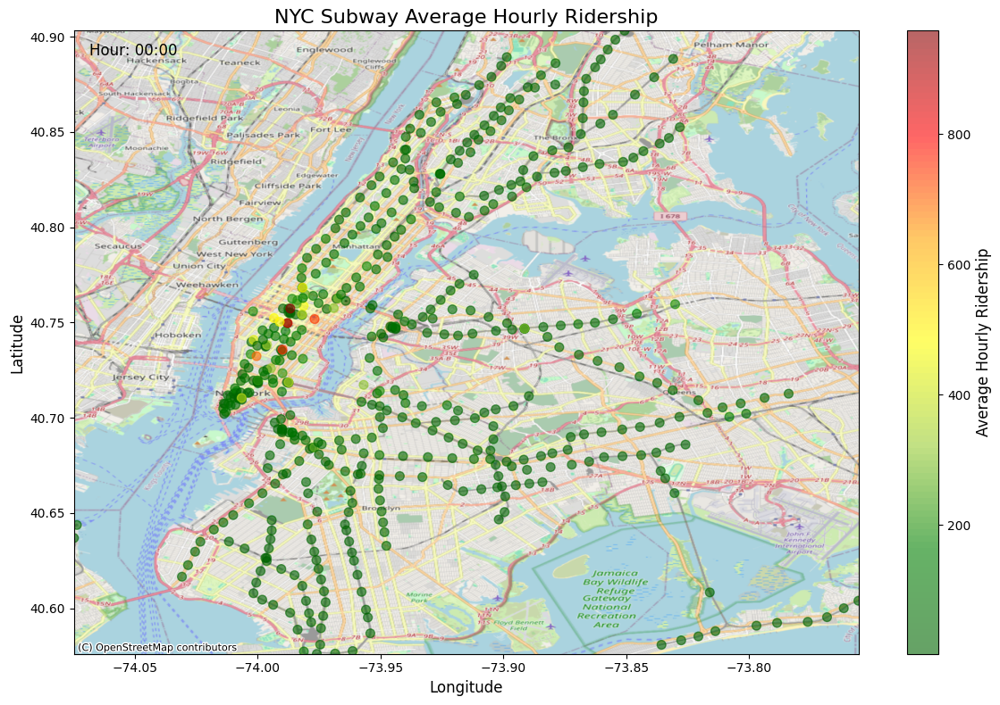

Animation saved successfully.


In [36]:
# Create an hourly timestamp column as datetime
df['hour'] = df['transit_timestamp'].dt.hour

# Group by station and hour, calculating mean hourly ridership
hourly_data = df.groupby(['station_complex', 'hour', 'latitude', 'longitude'])['ridership'].mean().reset_index()

# Calculate percentiles for normalization
low, high = np.percentile(hourly_data['ridership'], [5, 95])

# Create figure and axis
fig, ax = plt.subplots(figsize=(12, 8))

# Set up the plot limits based on your data
ax.set_xlim(df['longitude'].min(), df['longitude'].max())
ax.set_ylim(df['latitude'].min(), df['latitude'].max())
ax.set_title('NYC Subway Average Hourly Ridership', fontsize=16)
ax.set_xlabel('Longitude', fontsize=12)
ax.set_ylabel('Latitude', fontsize=12)

# Add a background map using contextily with OpenStreetMap
ctx.add_basemap(ax, crs="EPSG:4326", source=ctx.providers.OpenStreetMap.Mapnik)

# Initialize scatter plot
scatter = ax.scatter([], [], c=[], cmap=cmap, alpha=0.6, s=50, vmin=low, vmax=high)

# Add colorbar
cbar = plt.colorbar(scatter)
cbar.set_label('Average Hourly Ridership', fontsize=12)

# Add hour text
hour_text = ax.text(0.02, 0.98, '', transform=ax.transAxes, fontsize=12, verticalalignment='top')

# Animation update function
def update(frame):
    current_hour = frame
    current_data = hourly_data[hourly_data['hour'] == current_hour]
    
    scatter.set_offsets(current_data[['longitude', 'latitude']])
    scatter.set_array(current_data['ridership'])
    
    hour_text.set_text(f'Hour: {current_hour:02d}:00')
    
    return scatter, hour_text

# Create animation
ani = animation.FuncAnimation(fig, update, frames=24, interval=500, blit=True)

plt.tight_layout()
plt.show()

# Save animation
ani.save('nyc_subway_average_hourly_ridership_with_map.gif', writer='pillow', fps=2)
print("Animation saved successfully.")

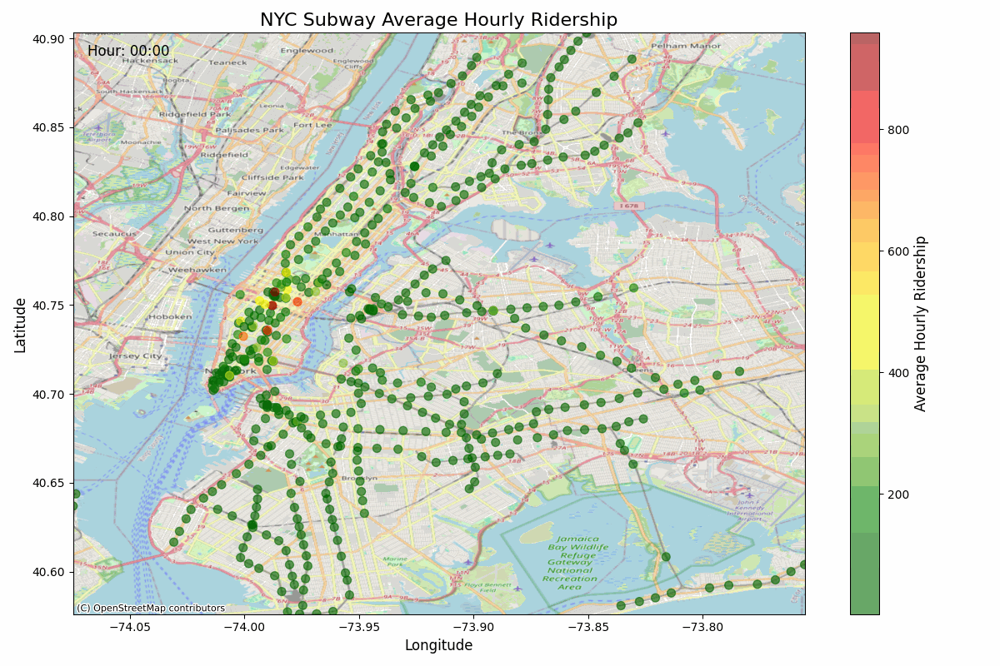

In [37]:
display(Image(filename='nyc_subway_average_hourly_ridership_with_map.gif'))

## Average Hourly Ridership with Graph of Top 10 Stations with Most Ridership [Video Link](https://drive.google.com/file/d/1y0CCrhNAVO9A_BWYnw9iXs5bMecBYL8q/view?usp=sharing)

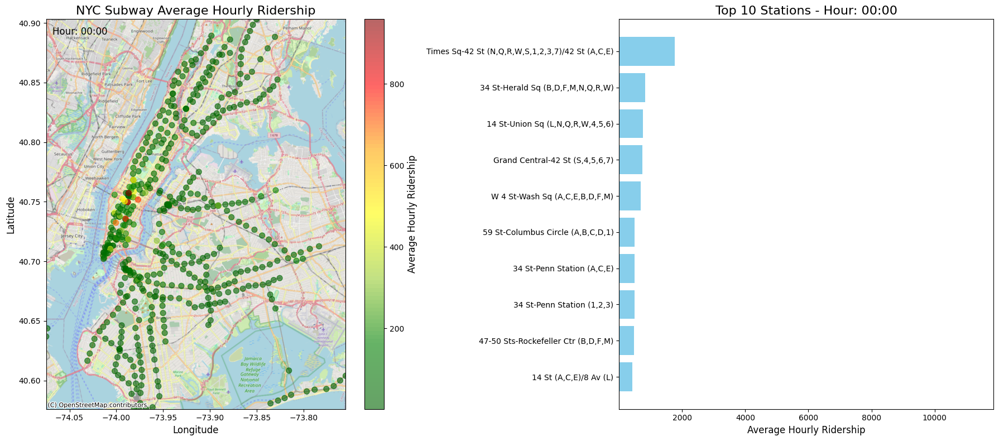

Animation saved successfully.


In [38]:
# Create an hourly timestamp column as datetime
df['hour'] = df['transit_timestamp'].dt.hour

# Group by station and hour, calculating mean hourly ridership
hourly_data = df.groupby(['station_complex', 'hour', 'latitude', 'longitude'])['ridership'].mean().reset_index()

# Calculate percentiles for normalization
low, high = np.percentile(hourly_data['ridership'], [5, 95])

# Determine fixed limits for the bar chart based on overall data
overall_min_ridership = hourly_data['ridership'].min()
overall_max_ridership = hourly_data['ridership'].max()

# Create figure and axes for scatter plot and bar chart
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 8))

# Set up the plot limits based on your data for scatter plot
ax1.set_xlim(df['longitude'].min(), df['longitude'].max())
ax1.set_ylim(df['latitude'].min(), df['latitude'].max())
ax1.set_title('NYC Subway Average Hourly Ridership', fontsize=16)
ax1.set_xlabel('Longitude', fontsize=12)
ax1.set_ylabel('Latitude', fontsize=12)

# Add a background map using contextily with OpenStreetMap
ctx.add_basemap(ax1, crs="EPSG:4326", source=ctx.providers.OpenStreetMap.Mapnik)

# Initialize scatter plot
scatter = ax1.scatter([], [], c=[], cmap=cmap, alpha=0.6, s=50, vmin=low, vmax=high)

# Add colorbar to scatter plot
cbar = plt.colorbar(scatter, ax=ax1)
cbar.set_label('Average Hourly Ridership', fontsize=12)

# Add hour text to scatter plot
hour_text = ax1.text(0.02, 0.98, '', transform=ax1.transAxes, fontsize=12, verticalalignment='top')

# Animation update function
def update(frame):
    current_hour = frame
    current_data = hourly_data[hourly_data['hour'] == current_hour]
    
    # Update scatter plot data
    scatter.set_offsets(current_data[['longitude', 'latitude']])
    scatter.set_array(current_data['ridership'])
    
    # Update hour text
    hour_text.set_text(f'Hour: {current_hour:02d}:00')
    
    # Get top 10 stations by ridership for the current hour
    top_stations = current_data.nlargest(10, 'ridership')
    
    # Clear previous bar chart and plot new data
    ax2.clear()
    ax2.barh(top_stations['station_complex'], top_stations['ridership'], color='skyblue')
    ax2.set_title(f'Top 10 Stations - Hour: {current_hour:02d}:00', fontsize=16)
    ax2.set_xlabel('Average Hourly Ridership', fontsize=12)
    
    # Set consistent x-axis limits for the bar chart based on overall data
    ax2.set_xlim(overall_min_ridership * 0.9, overall_max_ridership * 1.1)  # Adjust margins as needed
    
    ax2.invert_yaxis()  # Invert y-axis to have the highest ridership on top
    
    return scatter, hour_text

# Create animation
ani = animation.FuncAnimation(fig, update, frames=24, interval=500, blit=True)

plt.tight_layout()
plt.show()

# Save animation
ani.save('nyc_subway_average_hourly_ridership_with_map_and_graph.gif', writer='pillow', fps=2)
print("Animation saved successfully.")

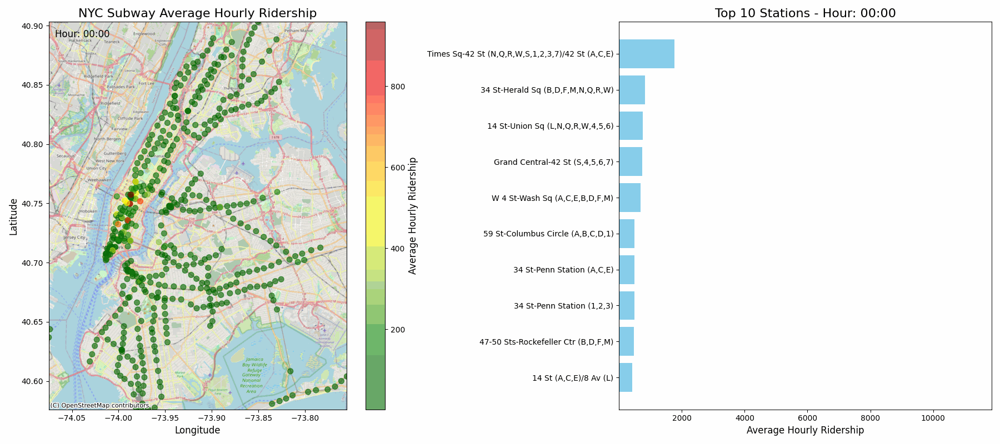

In [39]:
display(Image(filename='nyc_subway_average_hourly_ridership_with_map_and_graph.gif'))

## Build Folium Map

In [ ]:
arrests_df = pd.read_csv('NYPD_Arrests_small.csv')
subway_df = pd.read_csv('clean_subway.csv')

# Create a new dataframe with only the columns that have THEFT OF SERVICES in the PD_DESC column
turnstile_jumps = arrests_df[arrests_df['PD_DESC'].str.contains('THEFT OF SERVICES', case=False, na=False)]


len(turnstile_jumps)
turnstile_jumps.sample(5)

## CSV File for 2nd Challenge
Found the nearest subway station for each turnstile jumping incident based on their geographic coordinates. It calculates the distance between the incident locations and all subway stations, then counts how many incidents occurred at each station. The results, including the station names and their coordinates, are saved into a result_df dataframe. Additionally, it creates an enriched dataset of the arrest data, which includes details about each incident along with the nearest subway station, and exports this information to a CSV file. The result_df dataframe is used later to create a map  with the number of turnstile jumps at each station. The exported CSV file completes the second challenge.

In [ ]:
def find_nearest_station(lat, lon, stations):
    arrest_coords = np.array([[lat, lon]])
    station_coords = stations[['latitude', 'longitude']].values
    distances = cdist(arrest_coords, station_coords)
    nearest_index = distances.argmin()
    return stations.iloc[nearest_index]['station_complex']

# Apply function to get nearest station for each arrest
turnstile_jumps['nearest_station'] = turnstile_jumps.apply(
    lambda row: find_nearest_station(row['Latitude'], row['Longitude'], subway_df),
    axis=1
    )

# Count turnstile jumpings per station
jumps_per_station = turnstile_jumps['nearest_station'].value_counts().reset_index()
jumps_per_station.columns = ['station_complex', 'turnstile_jumpings']

# Merge with subway data to get coordinates
result_df = pd.merge(jumps_per_station, subway_df[['station_complex', 'latitude', 'longitude']], on='station_complex', how='left')
result_df = result_df.drop_duplicates(subset=['station_complex'], ignore_index=True)

# Select relevant columns for the enriched arrests data
enriched_arrests = turnstile_jumps[['ARREST_KEY', 'ARREST_DATE', 'PD_DESC', 'ARREST_BORO', 'Latitude', 'Longitude', 'nearest_station']]

# Export enriched arrests data
enriched_arrests.to_csv('enriched_turnstile_jumping_arrests.csv', index=False)
print("Exported 'enriched_turnstile_jumping_arrests.csv'")

In [42]:
# Dataset only goes from October to December 2023
enriched_arrests
enriched_arrests['ARREST_DATE'].agg(['min', 'max'])

min    10/09/2023
max    12/31/2023
Name: ARREST_DATE, dtype: object

In [43]:
result_df

,station_complex,turnstile_jumpings,latitude,longitude
0,"3 Av-149 St (2,5)",12,40.816110,-73.917755
1,"Times Sq-42 St (N,Q,R,W,S,1,2,3,7)/42 St (A,C,E)",8,40.757310,-73.987495
2,"Tremont Av (B,D)",7,40.850410,-73.905230
3,Rockaway Av (C),7,40.678340,-73.911950
4,Ralph Av (C),5,40.678820,-73.920784
...,...,...,...,...
66,"Newkirk Av-Little Haiti (2,5)",1,40.639970,-73.948410
67,"96 St (1,2,3)",1,40.793920,-73.972320
68,Morrison Av-Soundview (6),1,40.829520,-73.874520
69,"125 St (4,5,6)",1,40.804140,-73.937590


## Map with Number of Turnstile Jumps at Each Station using Folium

In [44]:
# Create a map centered on the mean coordinates of the arrests
center_lat = result_df['latitude'].mean()
center_lon = result_df['longitude'].mean()
nyc_map = folium.Map(location=[center_lat, center_lon], zoom_start=11)

# Create a MarkerCluster
marker_cluster = MarkerCluster().add_to(nyc_map)

 # Normalize marker sizes
max_hoppers = result_df['turnstile_jumpings'].max()
min_hoppers = result_df['turnstile_jumpings'].min()
min_marker_size = 5
max_marker_size = 20

# Add markers for each unique station
for idx, row in result_df.iterrows():
    # Calculate marker size
    if max_hoppers == min_hoppers:
        marker_size = (min_marker_size + max_marker_size) / 2
    
    else:
        marker_size = min_marker_size + ((row['turnstile_jumpings'] - min_hoppers) / (max_hoppers - min_hoppers)) * (max_marker_size - min_marker_size)
    
    # Create popup text
    popup_text = f"Station: {row['station_complex']}<br>Turnstile Jumpings: {row['turnstile_jumpings']}"

    # Add marker to the cluster
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=marker_size,
        popup=popup_text,
        tooltip=row['station_complex'],
        color='red',
        fill=True,
        fillColor='red',
        fillOpacity=0.7
    ).add_to(marker_cluster)

# Save the map
nyc_map.save("turnstile_hoppers_map_oct_to_dec_2023.html")

In [45]:
display(nyc_map)